In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns 
import plotly.graph_objects as go 
import plotly.express as px 

In [2]:
df=pd.read_csv("D:\\data\\zomato.csv")
df.head()

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,Yes,Yes,4.1/5,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,Yes,No,4.1/5,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet,Banashankari
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,Yes,No,3.8/5,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet,Banashankari
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,No,No,3.7/5,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet,Banashankari
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,No,No,3.8/5,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet,Banashankari


In [3]:
df.shape

(51717, 17)

In [4]:
df.columns

Index(['url', 'address', 'name', 'online_order', 'book_table', 'rate', 'votes',
       'phone', 'location', 'rest_type', 'dish_liked', 'cuisines',
       'approx_cost(for two people)', 'reviews_list', 'menu_item',
       'listed_in(type)', 'listed_in(city)'],
      dtype='object')

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51717 entries, 0 to 51716
Data columns (total 17 columns):
 #   Column                       Non-Null Count  Dtype 
---  ------                       --------------  ----- 
 0   url                          51717 non-null  object
 1   address                      51717 non-null  object
 2   name                         51717 non-null  object
 3   online_order                 51717 non-null  object
 4   book_table                   51717 non-null  object
 5   rate                         43942 non-null  object
 6   votes                        51717 non-null  int64 
 7   phone                        50509 non-null  object
 8   location                     51696 non-null  object
 9   rest_type                    51490 non-null  object
 10  dish_liked                   23639 non-null  object
 11  cuisines                     51672 non-null  object
 12  approx_cost(for two people)  51371 non-null  object
 13  reviews_list                 51

In [6]:
# droping the columns
df.drop(['url', 'address','phone','reviews_list','menu_item'],axis=1,inplace=True)

In [7]:
df.shape

(51717, 12)

In [8]:
df.duplicated().sum()

108

In [9]:
df.drop_duplicates(keep="first",inplace=True)  # use this 

In [10]:
df.shape

(51609, 12)

In [11]:
df.info()
# now pick every column one by one 
# fill missing values 
# and clean the data 
# remove outliers 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 51609 entries, 0 to 51716
Data columns (total 12 columns):
 #   Column                       Non-Null Count  Dtype 
---  ------                       --------------  ----- 
 0   name                         51609 non-null  object
 1   online_order                 51609 non-null  object
 2   book_table                   51609 non-null  object
 3   rate                         43854 non-null  object
 4   votes                        51609 non-null  int64 
 5   location                     51588 non-null  object
 6   rest_type                    51382 non-null  object
 7   dish_liked                   23595 non-null  object
 8   cuisines                     51564 non-null  object
 9   approx_cost(for two people)  51265 non-null  object
 10  listed_in(type)              51609 non-null  object
 11  listed_in(city)              51609 non-null  object
dtypes: int64(1), object(11)
memory usage: 5.1+ MB


In [12]:
df["rate"].unique()
# in rate column missing value are present 
# "new" and "nan" values are there 
# and we don't need /5 or "4.3 
# let's start 

array(['4.1/5', '3.8/5', '3.7/5', '3.6/5', '4.6/5', '4.0/5', '4.2/5',
       '3.9/5', '3.1/5', '3.0/5', '3.2/5', '3.3/5', '2.8/5', '4.4/5',
       '4.3/5', 'NEW', '2.9/5', '3.5/5', nan, '2.6/5', '3.8 /5', '3.4/5',
       '4.5/5', '2.5/5', '2.7/5', '4.7/5', '2.4/5', '2.2/5', '2.3/5',
       '3.4 /5', '-', '3.6 /5', '4.8/5', '3.9 /5', '4.2 /5', '4.0 /5',
       '4.1 /5', '3.7 /5', '3.1 /5', '2.9 /5', '3.3 /5', '2.8 /5',
       '3.5 /5', '2.7 /5', '2.5 /5', '3.2 /5', '2.6 /5', '4.5 /5',
       '4.3 /5', '4.4 /5', '4.9/5', '2.1/5', '2.0/5', '1.8/5', '4.6 /5',
       '4.9 /5', '3.0 /5', '4.8 /5', '2.3 /5', '4.7 /5', '2.4 /5',
       '2.1 /5', '2.2 /5', '2.0 /5', '1.8 /5'], dtype=object)

In [13]:
def handlerate(value):
    if(value=='NEW' or value=='-'):
        return np.nan
    else:
        value = str(value).split('/')
        value = value[0]
        return float(value)
    
df['rate'] = df['rate'].apply(handlerate)
df['rate'].head()

0    4.1
1    4.1
2    3.8
3    3.7
4    3.8
Name: rate, dtype: float64

In [14]:
## filling missing value of rate column 
# with mean bcz there are no outliers 

In [15]:
df["rate"].isnull().sum()

10019

In [16]:
df["rate"]=df["rate"].fillna(df["rate"].mean())

In [17]:
df["rate"].isnull().sum()

0

In [18]:
df.head()

,name,online_order,book_table,rate,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),listed_in(type),listed_in(city)
0,Jalsa,Yes,Yes,4.1,775,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,Buffet,Banashankari
1,Spice Elephant,Yes,No,4.1,787,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,Buffet,Banashankari
2,San Churro Cafe,Yes,No,3.8,918,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,Buffet,Banashankari
3,Addhuri Udupi Bhojana,No,No,3.7,88,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,Buffet,Banashankari
4,Grand Village,No,No,3.8,166,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,Buffet,Banashankari


In [19]:
df.describe(include="all")

,name,online_order,book_table,rate,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),listed_in(type),listed_in(city)
count,51609,51609,51609,51609.000000,51609.000000,51588,51382,23595,51564,51265,51609,51609
unique,8792,2,2,NaN,NaN,93,93,5271,2723,70,7,30
top,Cafe Coffee Day,Yes,No,NaN,NaN,BTM,Quick Bites,Biryani,North Indian,300,Delivery,BTM
freq,96,30361,45193,NaN,NaN,5109,19096,182,2907,7558,25867,3266
mean,NaN,NaN,NaN,3.700142,283.283361,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,0.395393,803.282771,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,1.800000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,3.500000,7.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,3.700142,41.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,3.900000,198.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [20]:
df.drop(["name"],axis=1,inplace=True)
# name column have too many uniques values 

In [21]:
# as we observe in votes column 
# our mean is high as compared to min value , 25% and 50% 
# so there must be a outliers there 
# now we have to handle the outliers 

In [22]:
df["votes"].nunique()

2328

In [23]:
df["votes"].unique()

array([ 775,  787,  918, ..., 4957, 2382,  843], dtype=int64)

In [24]:
pd.set_option("display.max_rows",None)
df["votes"].value_counts(sort=True,ascending=False,dropna=False)

0        9994
4        1136
6         989
7         871
9         738
11        699
5         667
8         623
10        618
16        535
13        465
12        465
17        452
14        434
23        407
21        396
18        388
24        373
15        371
22        368
19        360
25        329
34        329
20        302
26        290
33        276
31        275
27        269
32        264
28        259
38        249
30        249
41        238
36        236
42        233
46        231
39        225
35        219
29        202
53        201
47        200
48        200
37        199
43        198
44        189
61        176
54        170
50        170
49        167
56        164
57        162
59        156
40        156
74        155
51        153
70        145
62        142
52        141
68        138
75        138
67        135
45        132
58        131
64        128
69        127
66        124
76        122
55        121
73        120
63        120
93        115
72    

In [25]:
df["location"].unique()

array(['Banashankari', 'Basavanagudi', 'Mysore Road', 'Jayanagar',
       'Kumaraswamy Layout', 'Rajarajeshwari Nagar', 'Vijay Nagar',
       'Uttarahalli', 'JP Nagar', 'South Bangalore', 'City Market',
       'Nagarbhavi', 'Bannerghatta Road', 'BTM', 'Kanakapura Road',
       'Bommanahalli', nan, 'CV Raman Nagar', 'Electronic City', 'HSR',
       'Marathahalli', 'Sarjapur Road', 'Wilson Garden', 'Shanti Nagar',
       'Koramangala 5th Block', 'Koramangala 8th Block', 'Richmond Road',
       'Koramangala 7th Block', 'Jalahalli', 'Koramangala 4th Block',
       'Bellandur', 'Whitefield', 'East Bangalore', 'Old Airport Road',
       'Indiranagar', 'Koramangala 1st Block', 'Frazer Town', 'RT Nagar',
       'MG Road', 'Brigade Road', 'Lavelle Road', 'Church Street',
       'Ulsoor', 'Residency Road', 'Shivajinagar', 'Infantry Road',
       'St. Marks Road', 'Cunningham Road', 'Race Course Road',
       'Commercial Street', 'Vasanth Nagar', 'HBR Layout', 'Domlur',
       'Ejipura', 'Jeevan 

# Analysis of cafe based on their online delivery 

In [26]:
labels=["yes","no"]
values=df["online_order"].value_counts()
colors=["mediumliteblue","darkorange"]
fig=go.Figure(data=[go.Pie(labels=labels,values=values,hole=0.4)]) # we can write title="Online Order"
#  pull = [0,0.25,0,0] 
fig.update_traces(hoverinfo="label+percent",textinfo="value",textfont_size=20,
              marker=dict(colors=colors,line=dict(color='#000000', width=3)))
fig.update_layout(title="Online Order",
                 titlefont={'size': 30})
fig.show()               
#fig.update_traces(hoverinfo='label+percent', textinfo='value', textfont_size=20,
    #             marker=dict(colors=colors,line=dict(color='#000000', width=3)),
    #             title_font={"size":20,"color":"darkred"})               

#fig6.add_annotation(x= 0.5, y = 0.5,
  #                  text = 'Year 2017',
  #                  font = dict(size=20,family='Verdana', 
  #                              color='black'),
  #                  showarrow = False)                  

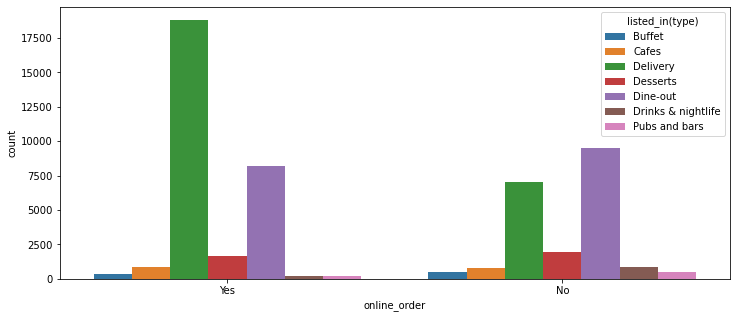

In [27]:
plt.figure(figsize=(12,5))
sns.countplot(data=df,x="online_order",hue="listed_in(type)")
plt.show()

# Analysis of cafe based on their table booking facility 

In [28]:
labels=["yes","no"]
values=df["book_table"].value_counts()
color=["mediumliteblue","darkorange"]
fig1=go.Figure(data=[go.Pie(labels=labels,values=values,hole=0.5)])
fig.update_traces(hoverinfo="label+percent+text",textinfo="value",textfont_size=20,
                 marker=dict(colors=color,line=dict(color="black",width=3)))
fig.update_layout(title="Book Table ",titlefont={"size":30})
fig.show()

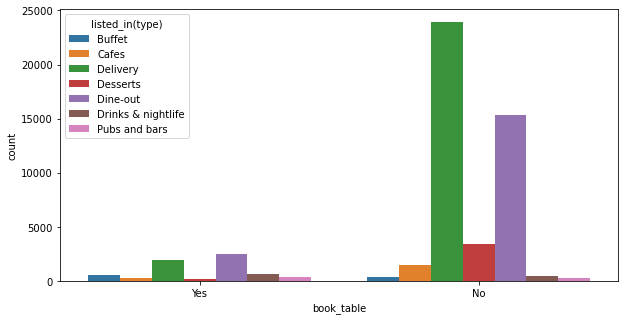

In [29]:
plt.figure(figsize=(10,5))
sns.countplot(data=df,x="book_table",hue="listed_in(type)")
plt.show()

In [30]:
# analysis based on rating 
labels=["1.5-3","3-3.5","3.5-4","4-4.5","4.5-5"]
values=[
       (df["rate"]<3).sum(),
       (df["rate"]<3.5).sum(),
       (df["rate"]<4).sum(),
       (df["rate"]<4.5).sum(),
       (df["rate"]<5).sum()]
colors=["mediumlateblue","darkorange"]
fig=go.Figure(data=[go.Pie(labels=labels,values=values,hole=0.4)])
fig.update_traces(hoverinfo="label+percent+text",textinfo="value",textfont_size=20,
                 marker=dict(colors=colors,line=dict(color="black",width=3)))
fig.update_layout(title="No. of Cafe based on their rating",titlefont={"size":30})
fig.show()

In [31]:
# analysis of cafe based on table booking and how rating is related to it 

<AxesSubplot:xlabel='rate', ylabel='count'>

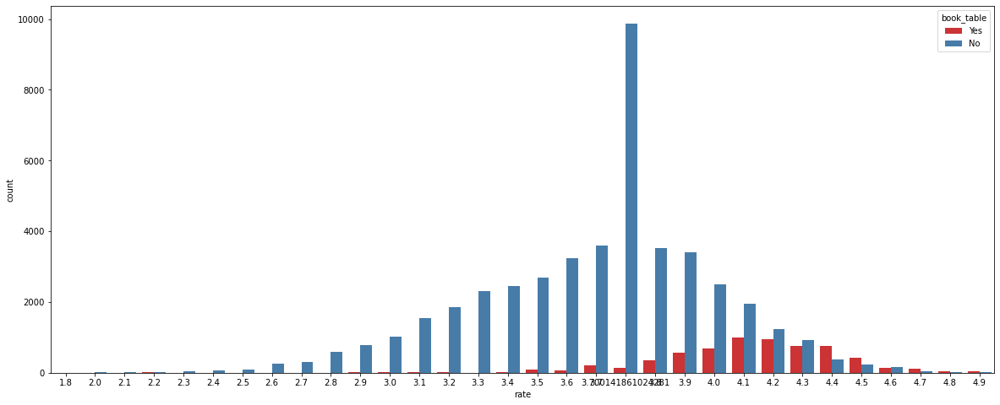

In [32]:
plt.figure(figsize=(20,8))
sns.countplot(data=df,x="rate",hue="book_table",palette="Set1")

In [33]:
# analysis of cafe based on their online order and how rating is related to it 

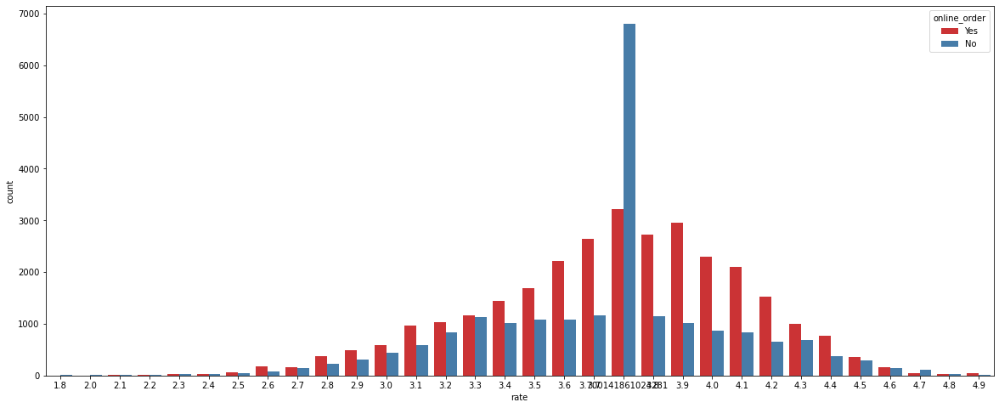

In [34]:
plt.figure(figsize=(20,8))
sns.countplot(data=df,x="rate",hue="online_order",palette="Set1")
plt.show()

 it is clearly visible that that book table does not affect much to a cafe rating in comparision to onlinr delivery.
    people tend to prefer order online since they can get various offers from it. 
    that's  why online delivery is more important for cafe in bangalore

# Analysis of cafe based on their location 

In [35]:
# lets check max count 
print("maximum number of cafe present at:")
count_max=max(df["location"].value_counts(ascending=True))
for x,y in (df["location"].value_counts(ascending=True)).items():
    if (y==count_max):
        print(x)

maximum number of cafe present at:
BTM


In [ ]:
px.bar(data_frame=df,x="location",text="online_order")

In [37]:
df["listed_in(type)"].unique()

array(['Buffet', 'Cafes', 'Delivery', 'Desserts', 'Dine-out',
       'Drinks & nightlife', 'Pubs and bars'], dtype=object)

In [ ]:
px.bar(data_frame=df,x="listed_in(type)",y="online_order",color="listed_in(type)",
       opacity=0.9,barmode="group")

In [39]:

values=df["listed_in(type)"].value_counts()
labels=values.index
colors=["mediumlateblue","darkorange","darkyellow"]
fig=go.Figure(data=[go.Pie(labels=labels,values=values,hole=0.5)])
fig.update_traces(hoverinfo="label+percent",textinfo="value",textfont_size=20,
                 marker=dict(colors=colors,line=dict(color="black",width=3)))
fig.update_layout(title="Types of cafes ",titlefont={"size":30})
fig.show()

# analysis of cafe based on their subcity type

In [40]:
df["listed_in(city)"].unique()

array(['Banashankari', 'Bannerghatta Road', 'Basavanagudi', 'Bellandur',
       'Brigade Road', 'Brookefield', 'BTM', 'Church Street',
       'Electronic City', 'Frazer Town', 'HSR', 'Indiranagar',
       'Jayanagar', 'JP Nagar', 'Kalyan Nagar', 'Kammanahalli',
       'Koramangala 4th Block', 'Koramangala 5th Block',
       'Koramangala 6th Block', 'Koramangala 7th Block', 'Lavelle Road',
       'Malleshwaram', 'Marathahalli', 'MG Road', 'New BEL Road',
       'Old Airport Road', 'Rajajinagar', 'Residency Road',
       'Sarjapur Road', 'Whitefield'], dtype=object)

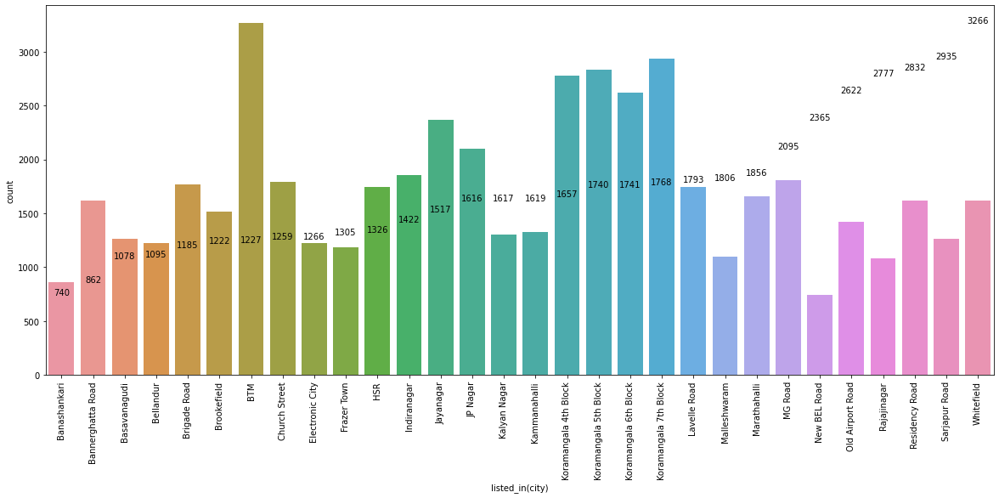

In [41]:
plt.figure(figsize=(20,8))
sns.countplot(data=df,x="listed_in(city)")
plt.xticks(rotation=90)
citycount=df["listed_in(city)"].value_counts(ascending=True)
for v in range(len(citycount)):
    plt.text(v,citycount[v],citycount[v],fontsize=10,color="black",horizontalalignment=("center"))
plt.show()

In [ ]:
px.bar(data_frame=df,x=df["approx_cost(for two people)"])


In [ ]:
sns.countplot(df["approx_cost(for two people)"])

In [ ]:
df[(df["votes"]>=300)& (df["rate"]>=4)].describe()

# analysis of cafe based on their coffee and foodtype 

In [ ]:
df["cuisines"].unique()

In [ ]:
def handlecuisines(value):
    a=str(value)
    b=a.split(",")
    return b[0]

In [ ]:
df["cuisines"]=df["cuisines"].apply(handlecuisines) #df["cuisines"] 

In [ ]:
df["cuisines"].value_counts(sort=True)

In [ ]:
values=df["cuisines"].value_counts(sort=True)[:20]
labels=values.index
colors=["mediumlateblue","darkorange"]
fig=go.Figure(data=[go.Pie(values=values,labels=labels,hole=0.3)]) 
fig.update_traces(hoverinfo="label+percent",textinfo="value",textfont_size=20,
                 marker=dict(colors=colors,line=dict(color="black",width=3)))
fig.update_layout(title="Top cuisines of Bangalore",titlefont={"size":30})
fig.show()

# Get All The North Indian Food Serving Cafe

In [ ]:
NorthIndianFoodCafe=df[df["cuisines"]=='North Indian']
NorthIndianFoodCafe.head()

# Get All The Chinese Food Serving Cafe 

In [ ]:
ChineseFoodCafe=df[df["cuisines"]=='Chinese']
ChineseFoodCafe.shape[0] # gives rows value only 

In [ ]:
df.head()

# Most liked dishes in Bangalore

 let store the dishes liked in seperate list and then analyse it 

In [53]:
import re 

In [54]:
df=df[df["dish_liked"].notnull()]
df

,online_order,book_table,rate,votes,location,rest_type,dish_liked,cuisines,approx_cost(for two people),listed_in(type),listed_in(city)
0,Yes,Yes,4.100000,775,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,Buffet,Banashankari
1,Yes,No,4.100000,787,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,Buffet,Banashankari
2,Yes,No,3.800000,918,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,Buffet,Banashankari
3,No,No,3.700000,88,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,Buffet,Banashankari
4,No,No,3.800000,166,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,Buffet,Banashankari
5,Yes,No,3.800000,286,Basavanagudi,Casual Dining,"Onion Rings, Pasta, Kadhai Paneer, Salads, Sal...",North Indian,600,Buffet,Banashankari
7,Yes,Yes,4.600000,2556,Banashankari,"Casual Dining, Cafe","Farmhouse Pizza, Chocolate Banana, Virgin Moji...","Pizza, Cafe, Italian",600,Cafes,Banashankari
8,Yes,No,4.000000,324,Banashankari,Cafe,"Pizza, Mocktails, Coffee, Nachos, Salad, Pasta...","Cafe, Italian, Continental",700,Cafes,Banashankari
9,Yes,No,4.200000,504,Banashankari,Cafe,"Waffles, Pasta, Coleslaw Sandwich, Choco Waffl...","Cafe, Mexican, Italian, Momos, Beverages",550,Cafes,Banashankari
10,Yes,No,4.100000,402,Banashankari,Cafe,"Waffles, Pasta, Crispy Chicken, Honey Chilli C...",Cafe,500,Cafes,Banashankari
